<a href="https://colab.research.google.com/github/victor-roris/ML-learning/blob/master/ComputerVision/DeepLearning_ComputerVision_YoloV5_Custom_DataSpartan_Dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# YoloV5 - Custom DataSpartan dataset

Notebook to train a YoloV5 model [link](https://github.com/ultralytics/yolov5) with custom dataset generated in the `AIDocs` project of DataSpartan. This dataset is about document segmentation and it is accesible from my profesional drive account (**this is private and not public available**).

This notebook is an adaptation from: [tutorial notebooks 1](https://colab.research.google.com/drive/1gDZ2xcTOgR39tGGs-EZ6i3RTs16wmzZQ#scrollTo=VUOiNLtMP5aG) [tutorial notebooks 2](https://colab.research.google.com/github/ultralytics/yolov5/blob/master/tutorial.ipynb)

#Install Dependencies

_(Remember to choose GPU in Runtime if not already selected. Runtime --> Change Runtime Type --> Hardware accelerator --> GPU)_

In [1]:
!git clone https://github.com/ultralytics/yolov5  # clone repo
!pip install -r yolov5/requirements.txt  # install dependencies
%cd yolov5

import torch
from IPython.display import Image, clear_output  # to display images
from utils.google_utils import gdrive_download  # to download models/datasets

clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Setup complete. Using torch 1.5.1+cu101 _CudaDeviceProperties(name='Tesla K80', major=3, minor=7, total_memory=11441MB, multi_processor_count=13)


In [2]:
yolo_folderpath = "/content/yolov5"

## Custom dataset

This dataset is accesible from my profesional driver account (**this is not public available**)

This database is a zip file with a folder with images and other folder with label texts. 

In particular, the format of these annotation documents follow the [`darknet format`](https://github.com/ultralytics/yolov3/wiki/Train-Custom-Data)

In this code we download and unzip this file. Then, we split the annotation in `train` and `validation` folders. Finally, we create the metadata file with the information to the yolo model.

Connect with my drive (@dataspartan)

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


Untar the driver's yolo zip

In [4]:
# Export dataset filepath
dataset_folderpath = "/content/yolo/"

In [5]:
!rm -R {dataset_folderpath}

rm: cannot remove '/content/yolo/': No such file or directory


In [6]:
from pathlib import Path
def mkdir(sfolderpath):
  folderpath = Path(sfolderpath)
  folderpath.mkdir(parents=True, exist_ok=True)

mkdir(dataset_folderpath)

In [7]:
!tar -xvf /content/drive/My\ Drive/DATASPARTAN/PROYECTOS/AI-DOCUMENTS/SEGMENTATION/export..2020.07.02.tar.gz -C {dataset_folderpath}

clear_output()

!ls {dataset_folderpath}

image  yolo_data.yaml  yolo_labels


Split the yolo labels and images in sub folders to be processed by the yolo model

In [8]:
from os import path
from os import listdir
from os.path import isfile, join

path_images = join(dataset_folderpath, "image")
path_labels = join(dataset_folderpath, "yolo_labels")

def get_processable_filenames(doc_image_path: str, doc_mask_path: str):
    img_filenames = [path.splitext(f)[0] for f in listdir(doc_image_path) if isfile(join(doc_image_path, f))]
    label_filenames = [path.splitext(f)[0] for f in listdir(doc_mask_path) if isfile(join(doc_mask_path, f))]
    img_filenames.sort()
    label_filenames.sort()
    filenames = list(set(img_filenames) & set(label_filenames)) # Intersection
    return filenames
filenames = get_processable_filenames(path_images, path_labels)
print(f'Number of examples: {len(filenames)}')

Number of examples: 3211


In [9]:
import os
for filename in filenames:
  if not isfile( os.path.join(path_images, filename + ".png") ):
    print(filename)

In [10]:
import random
random.shuffle(filenames)
percent = 0.7

pox_break = int(len(filenames)*percent)
train_filenames = filenames[0:pox_break]
val_filenames = filenames[pox_break:]

print(f"Number of training examples : {len(train_filenames)}")
print(f"Number of validation examples : {len(val_filenames)}")

Number of training examples : 2247
Number of validation examples : 964


In [11]:
path_train_images = join(dataset_folderpath, "train/images")
path_train_labels = join(dataset_folderpath, "train/labels") 
path_val_images = join(dataset_folderpath, "val/images") 
path_val_labels = join(dataset_folderpath, "val/labels")  

mkdir(path_train_images)
mkdir(path_train_labels)
mkdir(path_val_images)
mkdir(path_val_labels)

In [12]:
! ls {dataset_folderpath}

image  train  val  yolo_data.yaml  yolo_labels


In [13]:
import shutil
import os

def move_filenames(filenames, path_images, path_labels, path_destination_images, path_destination_labels):

  for filename in filenames:

    if not isfile( os.path.join(path_images, filename + ".png") ):
      continue
    if not isfile( os.path.join(path_labels, filename + ".txt") ):
      continue

    shutil.move( os.path.join(path_images, filename + ".png"),
                os.path.join(path_destination_images, filename + ".png"))
    shutil.move( os.path.join(path_labels, filename + ".txt"),
                os.path.join(path_destination_labels, filename + ".txt"))
  
move_filenames(train_filenames, path_images, path_labels, path_train_images, path_train_labels )
move_filenames(val_filenames, path_images, path_labels, path_val_images, path_val_labels )

In [14]:
ntra_files = len([path.splitext(f)[0] for f in listdir(path_train_images) if isfile(join(path_train_images, f))])
nval_files = len([path.splitext(f)[0] for f in listdir(path_val_images) if isfile(join(path_val_images, f))])
print(f"Number of training examples {ntra_files}")
print(f"Number of validation examples {nval_files}")

Number of training examples 2247
Number of validation examples 964


In [15]:
!rm {path_images} -R
!rm {path_labels} -R

!ls {dataset_folderpath}

train  val  yolo_data.yaml


Generate the `data.yaml` with the metadata about the dataset to the model.

In [16]:
import yaml

yolo_filepath = "/content/yolo/yolo_data.yaml"
with open(yolo_filepath, 'w') as f:
    f.write(f'train: {path_train_images} \n')
    f.write(f'val: {path_val_images} \n')
    f.write(f'\n')
    f.write('nc: 6 \n')
    f.write("names: ['background', 'text', 'title', 'list', 'table', 'figure']  \n") 

In [17]:
!cat {yolo_filepath}

train: /content/yolo/train/images 
val: /content/yolo/val/images 

nc: 6 
names: ['background', 'text', 'title', 'list', 'table', 'figure']  


## Define Model Configuration and Architecture
We will write a yaml script that defines the parameters for our model like the number of classes, anchors, and each layer.

In [ ]:
# define number of classes based on YAML
import yaml
with open(yolo_filepath, 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

In [ ]:
##write custom model .yaml
#you can configure this based on other YOLOv5 models in the models directory
with open( join(yolo_folderpath, 'models/custom_yolov5s.yaml') , 'w') as f:
  # parameters
  f.write('nc: ' + num_classes + '\n')
  f.write('depth_multiple: 0.33'  + '\n') # model depth multiple
  f.write('width_multiple: 0.50'  + '\n')  # layer channel multiple
  f.write('\n')
  f.write('anchors:' + '\n')
  f.write('  - [10,13, 16,30, 33,23] ' + '\n')
  f.write('  - [30,61, 62,45, 59,119]' + '\n')
  f.write('  - [116,90, 156,198, 373,326] ' + '\n')
  f.write('\n')

  f.write('backbone:' + '\n')
  f.write('  [[-1, 1, Focus, [64, 3]],' + '\n')
  f.write('   [-1, 1, Conv, [128, 3, 2]],' + '\n')
  f.write('   [-1, 3, Bottleneck, [128]],' + '\n')
  f.write('   [-1, 1, Conv, [256, 3, 2]],' + '\n')
  f.write('   [-1, 9, BottleneckCSP, [256]],' + '\n')
  f.write('   [-1, 1, Conv, [512, 3, 2]], ' + '\n')
  f.write('   [-1, 9, BottleneckCSP, [512]],' + '\n')
  f.write('   [-1, 1, Conv, [1024, 3, 2]],' + '\n')
  f.write('   [-1, 1, SPP, [1024, [5, 9, 13]]],' + '\n')
  f.write('   [-1, 6, BottleneckCSP, [1024]],' + '\n')
  f.write('  ]' + '\n')
  f.write('\n')

  f.write('head:'  + '\n')
  f.write('  [[-1, 3, BottleneckCSP, [1024, False]],'  + '\n')
  f.write('   [-1, 1, nn.Conv2d, [na * (nc + 5), 1, 1, 0]],' + '\n')
  f.write('   [-2, 1, nn.Upsample, [None, 2, "nearest"]],' + '\n')
  
  f.write('   [[-1, 6], 1, Concat, [1]],' + '\n')
  f.write('   [-1, 1, Conv, [512, 1, 1]],' + '\n')
  f.write('   [-1, 3, BottleneckCSP, [512, False]],' + '\n')
  f.write('   [-1, 1, nn.Conv2d, [na * (nc + 5), 1, 1, 0]],' + '\n')
  
  f.write('   [-2, 1, nn.Upsample, [None, 2, "nearest"]],' + '\n')
  f.write('   [[-1, 4], 1, Concat, [1]],' + '\n')
  f.write('   [-1, 1, Conv, [256, 1, 1]],' + '\n')
  f.write('   [-1, 3, BottleneckCSP, [256, False]],' + '\n')
  f.write('   [-1, 1, nn.Conv2d, [na * (nc + 5), 1, 1, 0]],' + '\n')
  f.write('\n' )
  f.write('   [[], 1, Detect, [nc, anchors]],' + '\n')
  f.write('  ]' + '\n')

print('custom model config written!')

custom model config written!


## Train Custom YOLOv5 Detector

### Next, we'll fire off training!


Here, we are able to pass a number of arguments:
- **img:** define input image size
- **batch:** determine batch size
- **epochs:** define the number of training epochs. (Note: often, 3000+ are common here!)
- **data:** set the path to our yaml file
- **cfg:** specify our model configuration
- **weights:** specify a custom path to weights. (Note: you can download weights from the Ultralytics Google Drive [folder](https://drive.google.com/open?id=1Drs_Aiu7xx6S-ix95f9kNsA6ueKRpN2J))
- **name:** result names
- **nosave:** only save the final checkpoint
- **cache:** cache images for faster training

In [ ]:
%%time
!python {join(yolo_folderpath, 'train.py')} --batch 16 --epochs 100 \
  --data {yolo_filepath} --cfg {join(yolo_folderpath, 'models/custom_yolov5s.yaml')} \
  --weights '' --name yolov5s_results --nosave --cache

Apex recommended for faster mixed precision training: https://github.com/NVIDIA/apex
{'lr0': 0.01, 'momentum': 0.937, 'weight_decay': 0.0005, 'giou': 0.05, 'cls': 0.58, 'cls_pw': 1.0, 'obj': 1.0, 'obj_pw': 1.0, 'iou_t': 0.2, 'anchor_t': 4.0, 'fl_gamma': 0.0, 'hsv_h': 0.014, 'hsv_s': 0.68, 'hsv_v': 0.36, 'degrees': 0.0, 'translate': 0.0, 'scale': 0.5, 'shear': 0.0}
Namespace(adam=False, batch_size=16, bucket='', cache_images=True, cfg='/content/yolov5/models/custom_yolov5s.yaml', data='/content/yolo/yolo_data.yaml', device='', epochs=100, evolve=False, img_size=[640, 640], multi_scale=False, name='yolov5s_results', noautoanchor=False, nosave=True, notest=False, rect=False, resume=False, single_cls=False, weights='')
Using CUDA device0 _CudaDeviceProperties(name='Tesla P4', total_memory=7611MB)

2020-07-03 21:14:44.899981: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcudart.so.10.1
Start Tensorboard with "tensorboard --logdir=runs

# Evaluate Custom YOLOv5 Detector Performance

Training losses and performance metrics are saved to Tensorboard and also to a logfile defined above with the **--name** flag when we train. In our case, we named this `yolov5s_results`. (If given no name, it defaults to `results.txt`.) The results file is plotted as a png after training completes.

Note from Glenn: Partially completed `results.txt` files can be plotted with `from utils.utils import plot_results; plot_results()`.

In [ ]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

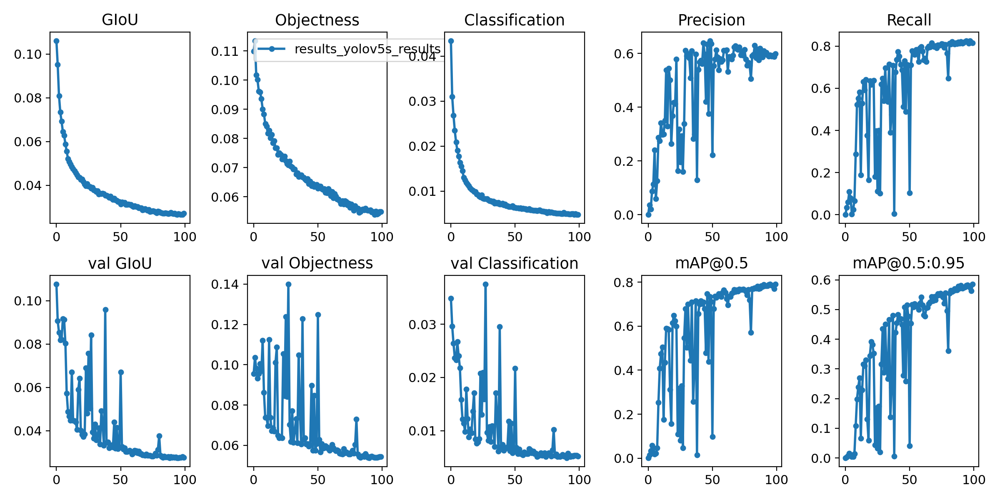

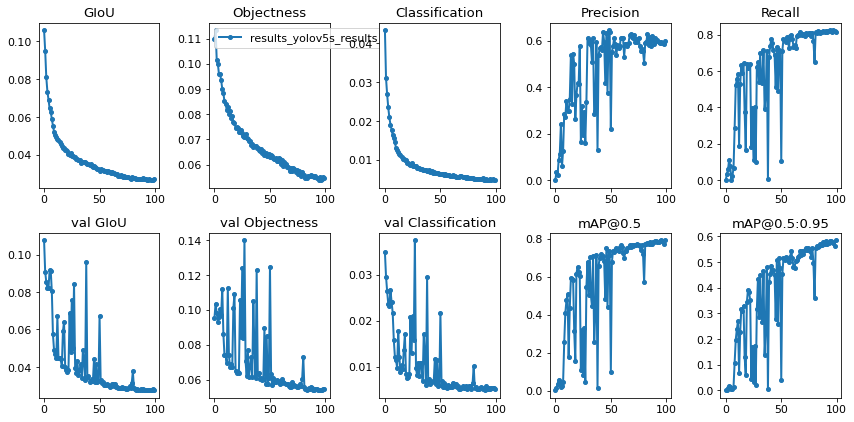

In [ ]:
# we can also output some older school graphs if the tensor board isn't working for whatever reason... 
from utils.utils import plot_results; plot_results()  # plot results.txt as results.png
Image(filename='./results.png', width=1000)  # view results.png

### Curious? Visualize Our Training Data with Labels

After training starts, view `train*.jpg` images to see training images, labels and augmentation effects.

Note a mosaic dataloader is used for training (shown below), a new dataloading concept developed by Glenn Jocher and first featured in [YOLOv4](https://arxiv.org/abs/2004.10934).

In [ ]:
# first, display our ground truth data
print("GROUND TRUTH TRAINING DATA:")
Image(filename='./test_batch0_gt.jpg', width=900)

GROUND TRUTH AUGMENTED TRAINING DATA:


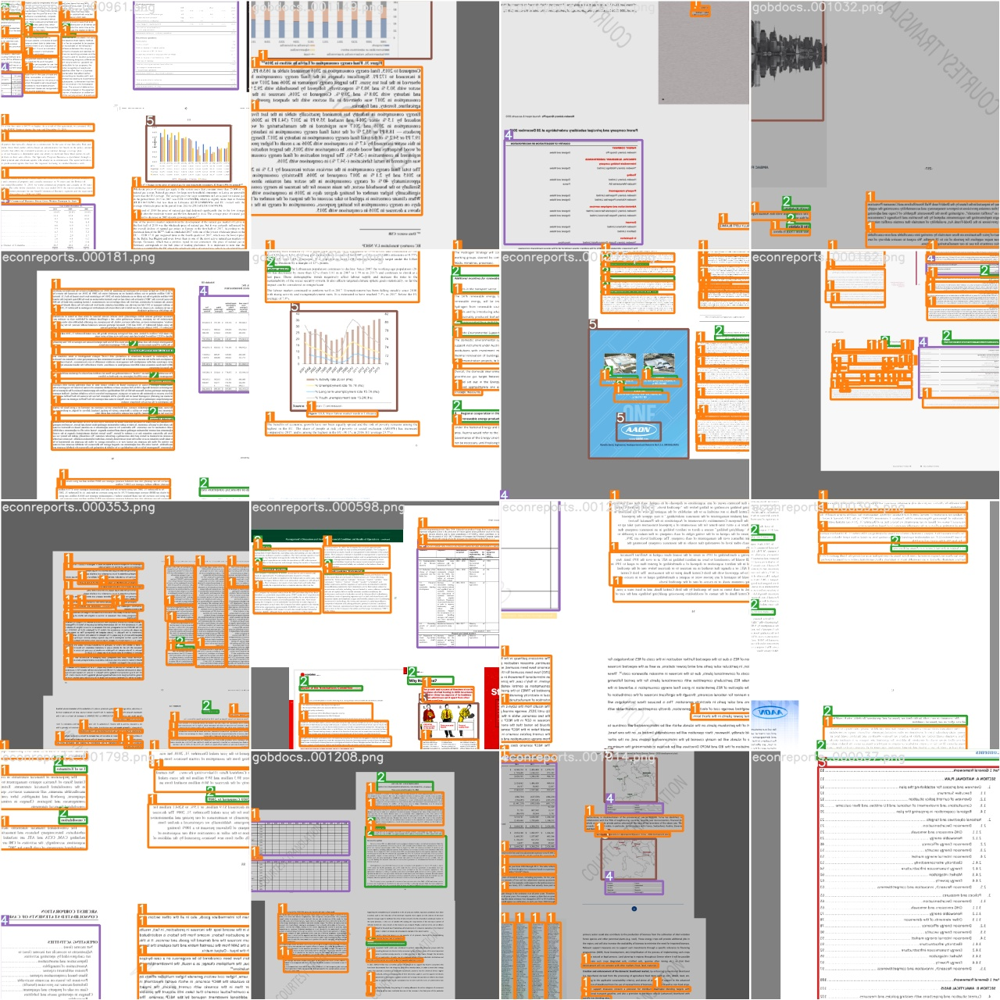

In [ ]:
# print out an augmented training example
print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename='./train_batch2.jpg', width=900)

#Run Inference  With Trained Weights
Run inference with a pretrained checkpoint on contents of `test/images` folder downloaded from Roboflow.

In [ ]:
# trained weights are saved by default in our weights folder
%ls weights/

download_weights.sh*  last_yolov5s_results.pt


In [ ]:
# when we ran this, we saw .007 second inference time. That is 140 FPS on a TESLA P100!
%cd /content/yolov5/
!python detect.py --weights weights/last_yolov5s_results.pt --conf 0.4 --source ../yolo/val/images

/content/yolov5
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', fourcc='mp4v', img_size=640, iou_thres=0.5, output='inference/output', save_txt=False, source='../yolo/val/images', view_img=False, weights='weights/last_yolov5s_results.pt')
Using CUDA device0 _CudaDeviceProperties(name='Tesla P4', total_memory=7611MB)

image 1/964 ../yolo/val/images/econreports..000000.png: 640x512 13 texts, 6 titles, Done. (0.011s)
image 2/964 ../yolo/val/images/econreports..000009.png: 640x512 11 texts, 2 titles, Done. (0.010s)
image 3/964 ../yolo/val/images/econreports..000018.png: 640x512 3 texts, 2 titles, 2 tables, Done. (0.010s)
image 4/964 ../yolo/val/images/econreports..000021.png: 640x512 6 texts, 1 titles, Done. (0.010s)
image 5/964 ../yolo/val/images/econreports..000025.png: 512x640 9 texts, 2 titles, Done. (0.011s)
image 6/964 ../yolo/val/images/econreports..000027.png: 640x512 5 texts, 2 titles, Done. (0.011s)
image 7/964 ../yolo/val/images/econreports.

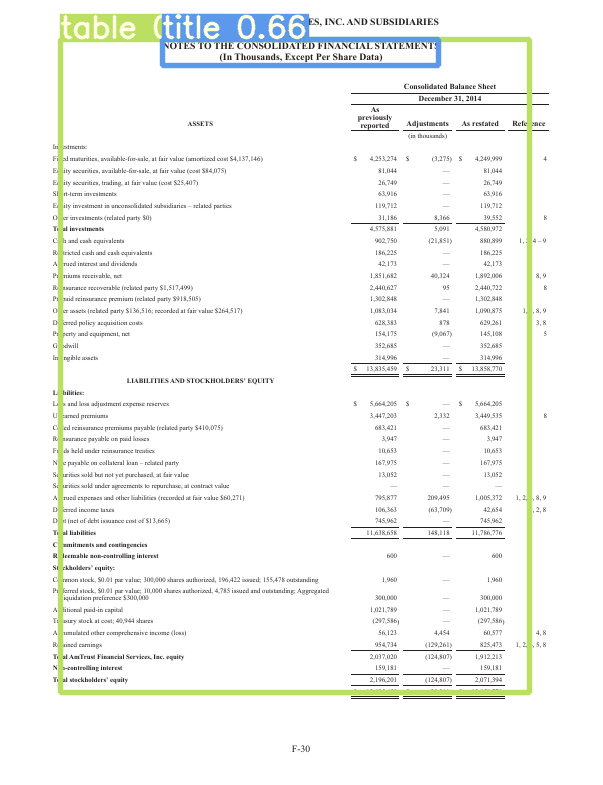

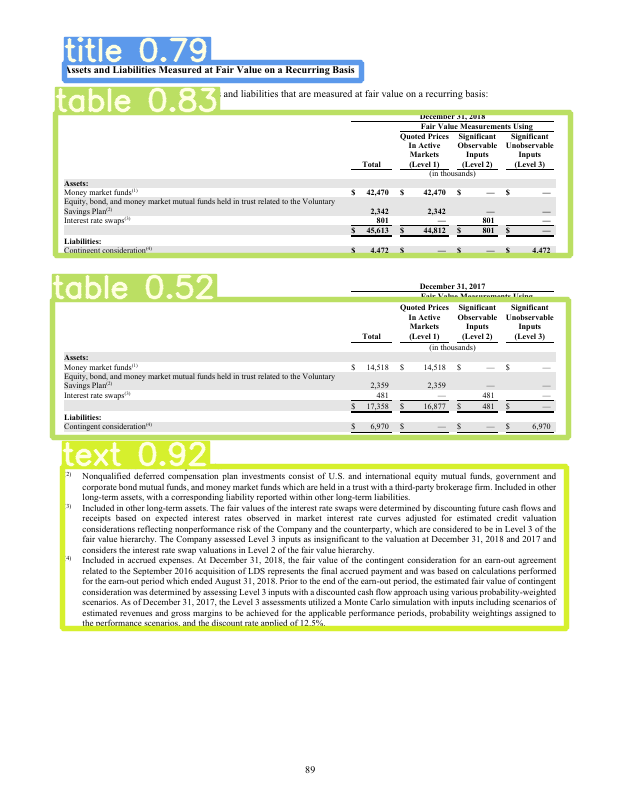

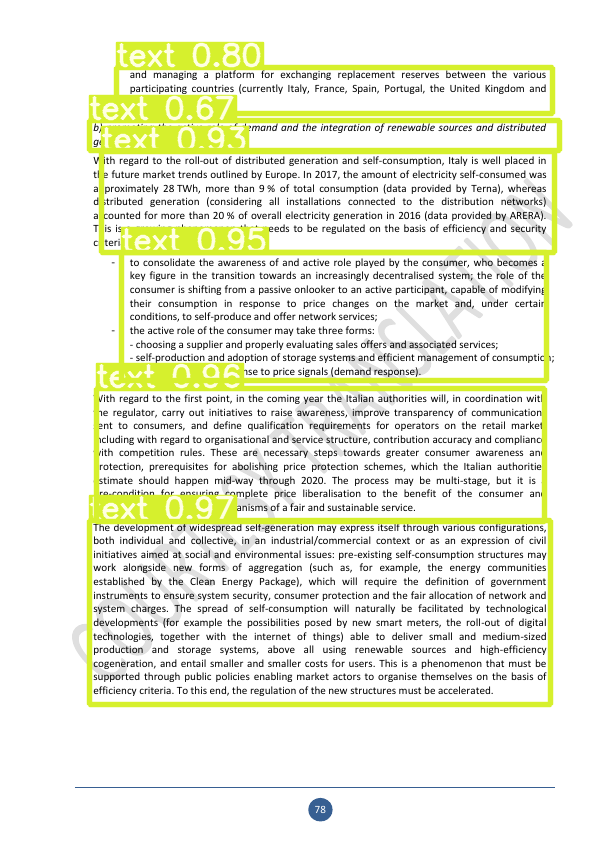

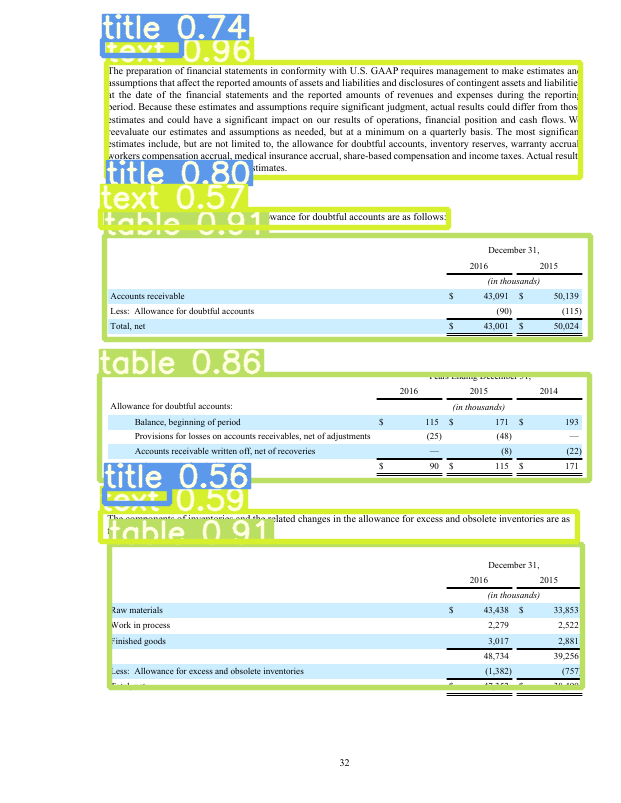

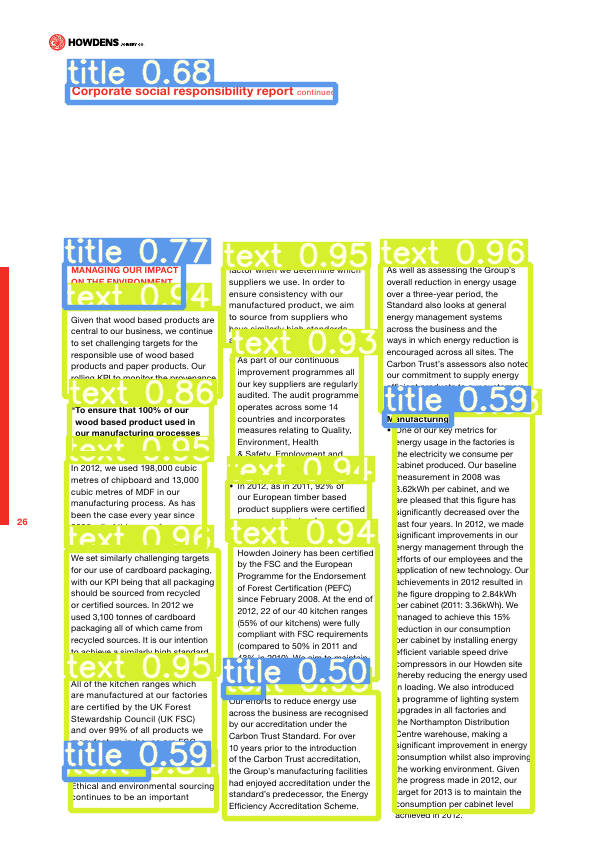

...

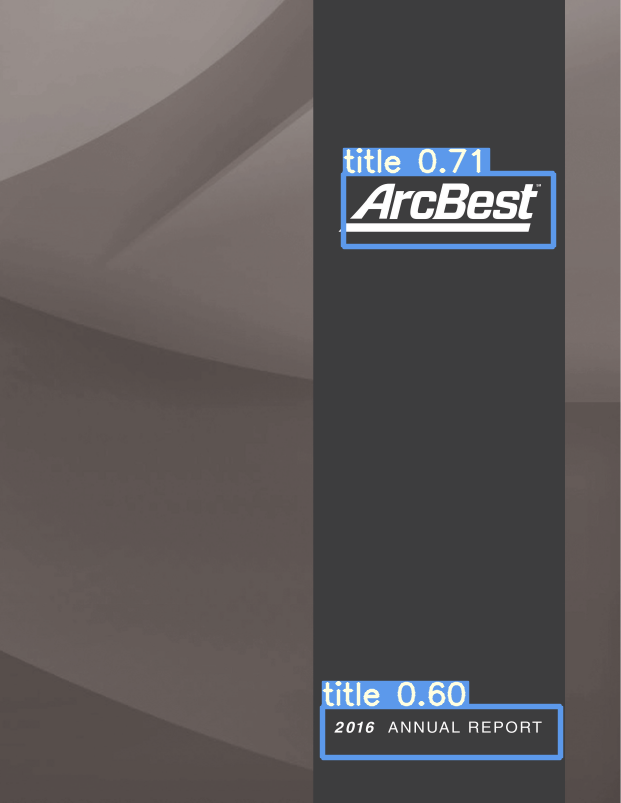

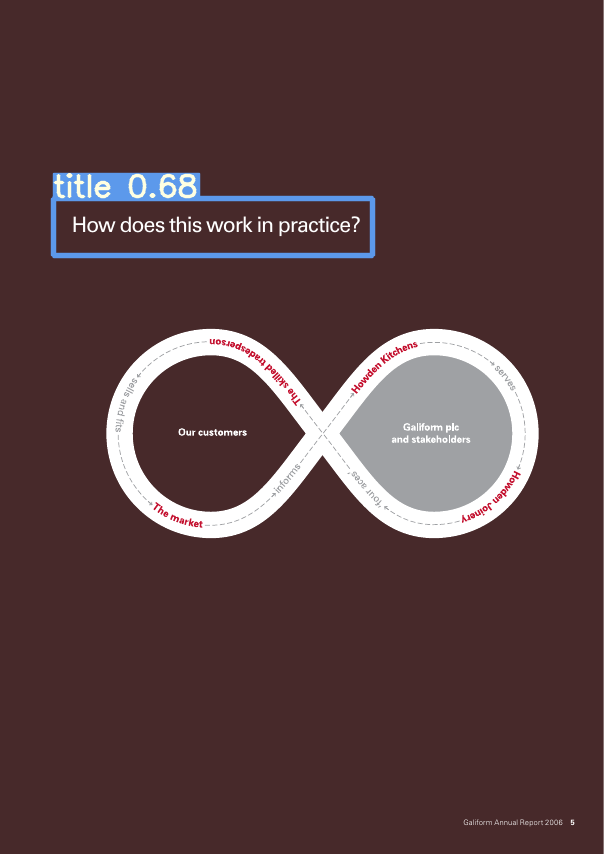

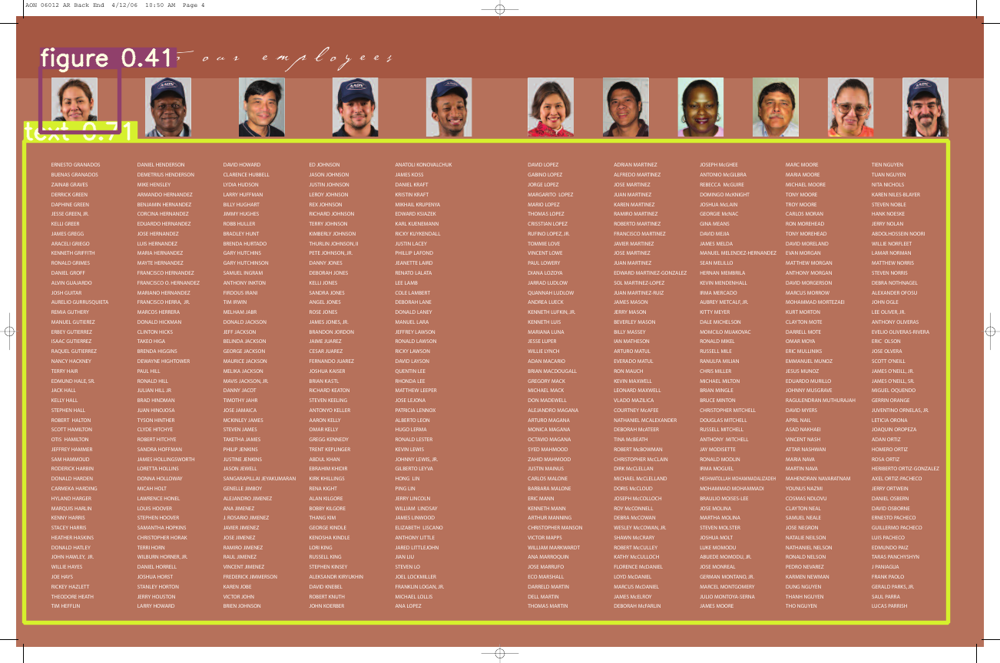

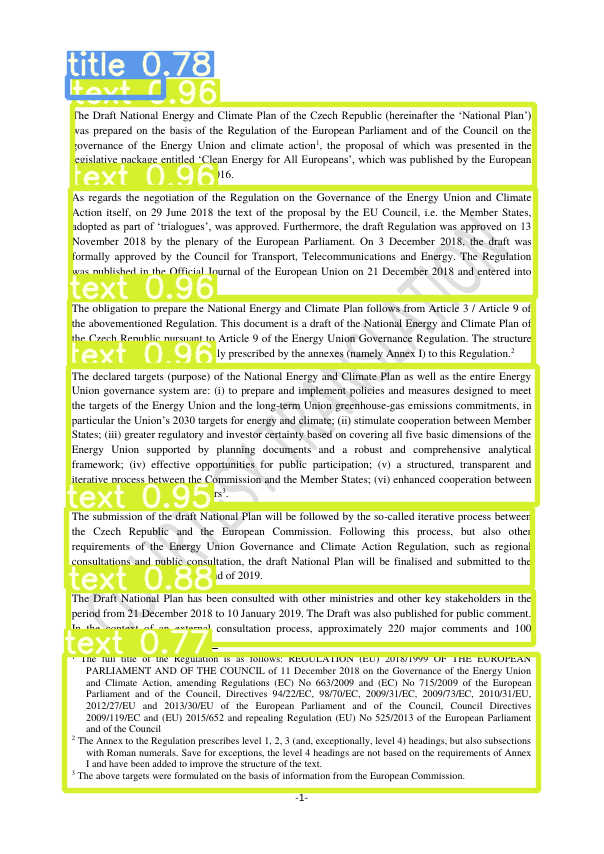

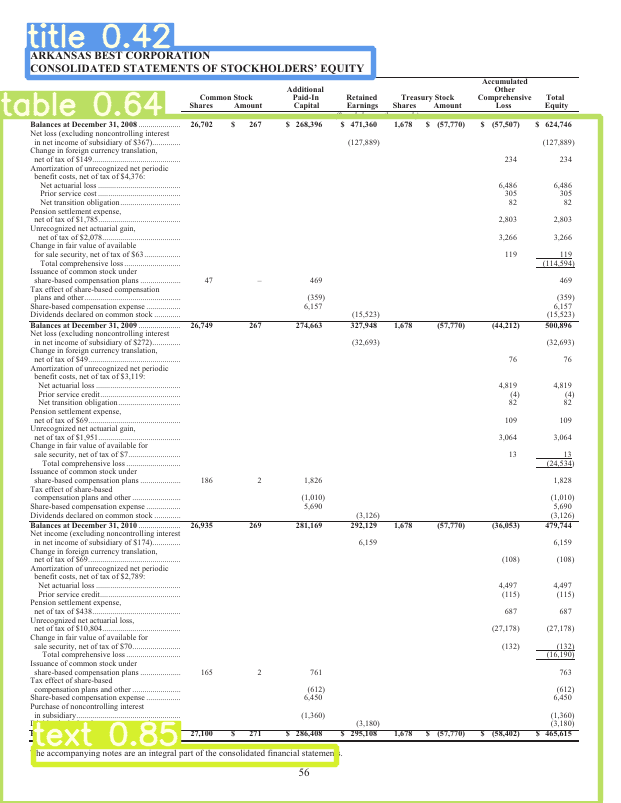

In [ ]:
#display inference on ALL test images
import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/inference/output/*.png'):
    display(Image(filename=imageName))
    print("\n")

# Export Trained Weights for Future Inference

Now that you have trained your custom detector, you can export the trained weights you have made here for inference on your device elsewhere

In [ ]:
!ls /content/yolov5/weights

download_weights.sh


In [ ]:
!cp /content/yolov5/weights/last_yolov5s_results.pt /content/drive/My\ Drive/last_yolov5s_results.pt

# Use Yolo model as library

I don't know how integrate this model in a library. But the current state, where you use the console to execute the prediction is not valid in production.

In this section, I test some options to integrate the model in a python library.

These are tests, this is not a final code!

### Predict with yolo using previous trained weights

* Download some test document images

In [14]:
import os
print(" > Download the test dataset ")
!wget https://www.dropbox.com/s/yow9mjgt7cs35c0/validation..doc..pages.tar.gz?dl=0  -O docpages.tar.gz
!tar -zxvf docpages.tar.gz && ! mv validation..doc..pages {dataset_folderpath} 
!rm docpages.tar.gz

 > Download the test dataset 
--2020-07-07 14:22:22--  https://www.dropbox.com/s/yow9mjgt7cs35c0/validation..doc..pages.tar.gz?dl=0
Resolving www.dropbox.com (www.dropbox.com)... 162.125.3.1, 2620:100:6018:1::a27d:301
Connecting to www.dropbox.com (www.dropbox.com)|162.125.3.1|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/raw/yow9mjgt7cs35c0/validation..doc..pages.tar.gz [following]
--2020-07-07 14:22:22--  https://www.dropbox.com/s/raw/yow9mjgt7cs35c0/validation..doc..pages.tar.gz
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://ucd4438d9f84ab80bdab57df901d.dl.dropboxusercontent.com/cd/0/inline/A7GxgGyaM5wLC6XXL_jXA-GXO80qDeDlZl0qMkh3sUJfNVBGYaMFyk1DxMpRgGu3zJptqDMPmxmDsrGKC9Vd7FkM-w-JmLgh5E56znGeCCJn7cCvrAlQVd9gE9OrBVhWDsI/file# [following]
--2020-07-07 14:22:22--  https://ucd4438d9f84ab80bdab57df901d.dl.dropboxusercontent.com/cd/0/inline/A7GxgGyaM5wLC6XXL_jXA-GXO80q

* Copy the trained weights to the yolov5 folder

In [15]:
!cp /content/drive/My\ Drive/last_yolov5s_results.pt /content/yolov5/weights/last_yolov5s_results.pt

In [16]:
!ls /content/yolov5/weights

download_weights.sh  last_yolov5s_results.pt


* Prediction with the copied weights

In [17]:
%cd /content/yolov5/
!python detect.py --weights weights/last_yolov5s_results.pt --conf 0.4 \
   --source {os.path.join(dataset_folderpath, "validation..doc..pages/" )} \
   --save-txt --output "output"

/content/yolov5
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', img_size=640, iou_thres=0.5, output='output', save_txt=True, source='/content/yolo/validation..doc..pages/', update=False, view_img=False, weights='weights/last_yolov5s_results.pt')
Using CUDA device0 _CudaDeviceProperties(name='Tesla K80', total_memory=11441MB)

/usr/local/lib/python3.6/dist-packages/torch/serialization.py:657: SourceChangeWarning: source code of class 'models.yolo.Model' has changed. you can retrieve the original source code by accessing the object's source attribute or set `torch.nn.Module.dump_patches = True` and use the patch tool to revert the changes.
  warnings.warn(msg, SourceChangeWarning)
image 1/95 /content/yolo/validation..doc..pages/econreports..001635.png: 640x512 3 texts, 1 titles, 1 tables, Done. (0.039s)
image 2/95 /content/yolo/validation..doc..pages/econreports..001636.png: 640x512 10 texts, 1 titles, Done. (0.027s)
image 3/95 /content/yolo/validati

The prediction produced a list of files in the `output` folder of the yolov5 project. 

For each input image, it produces a ouput image (with the box drawned) and a txt with each annotation predicted.

To integrate this code, only the txt file could be interesting.

In [18]:
!ls /content/yolov5/output/

econreports..001635.png  econreports..001667.png  gobdocs..001214.txt
econreports..001635.txt  econreports..001667.txt  gobdocs..001215.png
econreports..001636.png  econreports..001668.png  gobdocs..001215.txt
econreports..001636.txt  econreports..001668.txt  gobdocs..001216.png
econreports..001637.png  econreports..001669.png  gobdocs..001216.txt
econreports..001637.txt  econreports..001669.txt  gobdocs..001217.png
econreports..001638.png  econreports..001670.png  gobdocs..001217.txt
econreports..001638.txt  econreports..001670.txt  gobdocs..001218.png
econreports..001639.png  econreports..001671.png  gobdocs..001218.txt
econreports..001639.txt  econreports..001671.txt  gobdocs..001219.png
econreports..001640.png  econreports..001672.png  gobdocs..001219.txt
econreports..001640.txt  econreports..001672.txt  gobdocs..001220.png
econreports..001641.png  econreports..001673.png  gobdocs..001220.txt
econreports..001641.txt  econreports..001673.txt  gobdocs..001221.png
econreports..001642.

In [19]:
!cat /content/yolov5/output/econreports..001666.txt 

1 0.508052 0.846202 0.388084 0.0361146 
5 0.520934 0.667497 0.439614 0.239103 


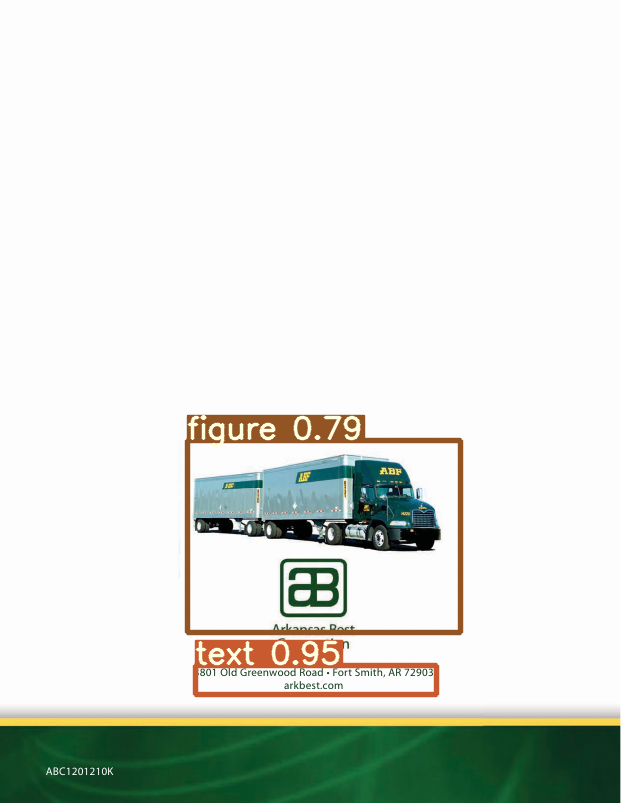

In [21]:
import cv2
from google.colab.patches import cv2_imshow
img = cv2.imread('/content/yolov5/output/econreports..001666.png')
cv2_imshow(img)

### Export

* YoloV5 allows export the model to: 
 - torchScript
 - Onnx
 - CoreML

 [link](https://github.com/ultralytics/yolov5/issues/251)

 Full export process not open sourced [link](https://github.com/ultralytics/yolov5/issues/312#issuecomment-654424223)

In [28]:
 !pip uninstall coremltools

Uninstalling coremltools-3.0b5:
  Would remove:
    /usr/local/bin/coremlconverter
    /usr/local/lib/python3.6/dist-packages/coremltools-3.0b5.dist-info/*
    /usr/local/lib/python3.6/dist-packages/coremltools/*
Proceed (y/n)? y
  Successfully uninstalled coremltools-3.0b5


In [8]:
! pip install onnx
! pip install coremltools
! pip install --upgrade coremltools

clear_output()

In [9]:
%cd /content/yolov5
!export PYTHONPATH="$PWD" && python models/export.py --weights weights/last_yolov5s_results.pt --batch 1  # export

/content/yolov5
Namespace(batch_size=1, img_size=[640, 640], weights='weights/last_yolov5s_results.pt')
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:657: SourceChangeWarning: source code of class 'models.yolo.Model' has changed. you can retrieve the original source code by accessing the object's source attribute or set `torch.nn.Module.dump_patches = True` and use the patch tool to revert the changes.
  warnings.warn(msg, SourceChangeWarning)

Starting TorchScript export with torch 1.5.1+cu101...
TorchScript export success, saved as weights/last_yolov5s_results.torchscript

Starting ONNX export with onnx 1.7.0...
Fusing layers... Model Summary: 120 layers, 6.8666e+06 parameters, 6.31725e+06 gradients
graph torch-jit-export (
  %images[FLOAT, 1x3x640x640]
) initializers (
  %model.0.conv.conv.bias[FLOAT, 32]
  %model.0.conv.conv.weight[FLOAT, 32x12x3x3]
  %model.1.conv.bias[FLOAT, 64]
  %model.1.conv.weight[FLOAT, 64x32x3x3]
  %model.10.bn.bias[FLOAT, 512]
  %model.10.b

The CoreML export fails

#### TorchScript tests

In [13]:
import torch  # This is all you need to use both PyTorch and TorchScript!
loaded = torch.jit.load('/content/yolov5/weights/last_yolov5s_results.torchscript')


In [14]:
import torch, torchvision
import PIL
from torchvision import transforms
from PIL import Image

def get_image(filename):
  im = Image.open(filename)
  # ImageNet pretrained models required input images to have width/height of 640
  # and color channels normalized according to ImageNet distribution.
  im_process = transforms.Compose([transforms.Resize([640, 640]),
                                   transforms.ToTensor(),
                                   transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                                    std=[0.229, 0.224, 0.225])])
  im = im_process(im) # 3 x 640 x 640
  return im.unsqueeze(0) # Add dimension to become 1 x 3 x 640 x 640

im = get_image('/content/yolo/validation..doc..pages/econreports..001635.png')

In [15]:
traced = torch.jit.trace(loaded, im)

/usr/local/lib/python3.6/dist-packages/torch/jit/__init__.py:868: UserWarning: The input to trace is already a ScriptModule, tracing it is a no-op. Returning the object as is.
  warnings.warn('The input to trace is already a ScriptModule, tracing it is a no-op. Returning the object as is.')


In [16]:
loaded(im)

[tensor([[[[[ 7.6378e-01, -1.2428e-01, -1.6433e-01,  ..., -3.8792e+00,
             -4.0585e+00, -3.1871e+00],
            [ 3.6817e-01,  1.8027e-01,  3.6875e-01,  ..., -3.8257e+00,
             -4.0332e+00, -2.8854e+00],
            [ 1.4329e-01,  2.6801e-01,  5.9178e-01,  ..., -3.7764e+00,
             -3.6511e+00, -2.8805e+00],
            ...,
            [-2.5707e-01,  6.8634e-01,  1.8883e-01,  ..., -4.3181e+00,
             -4.3110e+00, -3.4935e+00],
            [ 1.6431e-02,  3.3975e-01,  2.3021e-02,  ..., -4.3088e+00,
             -3.9240e+00, -3.4481e+00],
            [ 2.4925e-02,  3.6856e-01,  3.8010e-01,  ..., -4.3867e+00,
             -4.0946e+00, -3.5089e+00]],
 
           [[ 6.9559e-01, -6.2327e-01, -2.2283e-01,  ..., -3.5997e+00,
             -3.9465e+00, -2.4655e+00],
            [ 7.9521e-01, -6.6867e-01,  4.4181e-02,  ..., -3.1333e+00,
             -3.3413e+00, -1.2249e+00],
            [ 4.8042e-01, -9.9044e-01,  1.1543e-01,  ..., -3.1578e+00,
             -3.0654e

#### ONNX Tests
https://github.com/purelyvivid/yolo2_onnx/blob/master/2.yolo2_pytorch_onnx_load_model.ipynb

In [6]:
import onnx

# Load the ONNX model
model = onnx.load("/content/yolov5/weights/last_yolov5s_results.onnx")

# Check that the IR is well formed
onnx.checker.check_model(model)

# Print a human readable representation of the graph
#print(onnx.helper.printable_graph(model.graph))

In [7]:
type(model), type(model.graph), type(model.graph.node), len(model.graph.node)

(onnx.onnx_ONNX_REL_1_7_ml_pb2.ModelProto,
 onnx.onnx_ONNX_REL_1_7_ml_pb2.GraphProto,
 google.protobuf.pyext._message.RepeatedCompositeContainer,
 294)

In [8]:
node = model.graph.node[0]
type(node), type(node.attribute), type(node.attribute[0]), len(node.attribute)

(onnx.onnx_ONNX_REL_1_7_ml_pb2.NodeProto,
 google.protobuf.pyext._message.RepeatedCompositeContainer,
 onnx.onnx_ONNX_REL_1_7_ml_pb2.AttributeProto,
 1)

In [9]:
from PIL import Image 
import numpy as np


imgfile = '/content/yolo/validation..doc..pages/econreports..001635.png'
img = Image.open(imgfile).convert('RGB').resize( (640, 640) )

img_arr = np.array(img)
img_arr = np.expand_dims(img_arr, -1)
img_arr = np.transpose(img_arr, (3,2,0,1))/255.0

img_arr.shape

(1, 3, 640, 640)

* With TensorFlow > 2 we need install `onnx-tf` from the github.

In [23]:
import tensorflow as tf
tf.__version__

'2.2.0'

In [24]:
!pip uninstall onnx-tf

In [25]:
!git clone https://github.com/onnx/onnx-tensorflow.git && cd onnx-tensorflow

Cloning into 'onnx-tensorflow'...
remote: Enumerating objects: 49, done.
remote: Counting objects: 100% (49/49), done.
remote: Compressing objects: 100% (38/38), done.
remote: Total 4965 (delta 26), reused 16 (delta 11), pack-reused 4916
Receiving objects: 100% (4965/4965), 1.31 MiB | 11.00 MiB/s, done.
Resolving deltas: 100% (3779/3779), done.


In [26]:
! cd onnx-tensorflow && pip install -e .

Obtaining file:///content/yolov5/onnx-tensorflow
  Running setup.py develop for onnx-tf


In [4]:
# If it fails, you need restart the kernel
import onnx_tf 

In [10]:
%%time
# import onnx_caffe2.backend as backend_1
import onnx_tf.backend as backend
import numpy as np

rep = backend.prepare(model, device="CUDA:0") # or "CPU"

2020-07-07 15:26:16,547 - onnx-tf - INFO - Unknown op ConstantFill in domain `ai.onnx`.
2020-07-07 15:26:16,549 - onnx-tf - INFO - Unknown op ImageScaler in domain `ai.onnx`.


CPU times: user 9.99 s, sys: 1.65 s, total: 11.6 s
Wall time: 16.9 s


In [11]:
%%time
# For the Caffe2 backend:
#     rep.predict_net is the Caffe2 protobuf for the network
#     rep.workspace is the Caffe2 workspace for the network
#       (see the class onnx_caffe2.backend.Workspace)
outputs = rep.run(img_arr.astype(np.float32))
# To run networks with more than one input, pass a tuple
# rather than a single numpy ndarray.
print(outputs[0].shape, type(outputs))

InvalidArgumentError: ignored

In [ ]:
outputs = np.array(outputs).squeeze(0)
outputs.shape